## Vertical Profiles of Temperature, Salinity, and Velocity

This script creates the vertical profile figures in the main and appended text. You will need to download'revised_stat' folder to run this script. All code is written by Madie Mamer (mmamer3@gatech.edu)


In [73]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import cmocean as cmo
import matplotlib as mpl
from scipy.ndimage import uniform_filter1d
from labellines import labelLine, labelLines #https://pypi.org/project/matplotlib-label-lines/
from scipy.interpolate import griddata, splrep, splev

plt.rcParams.update({'xtick.labelsize' : 18})
plt.rcParams.update({'ytick.labelsize' : 18})
plt.rcParams.update({'axes.titlesize' : 24})
plt.rcParams.update({'axes.labelsize' : 22})
plt.rcParams.update({'legend.title_fontsize' : 20})
plt.rcParams.update({'legend.fontsize': 18})

## Reading in the time-averaged domain files from 'revised_stat'

In [94]:
path = 'averagedRuns'

### F1 ###
F1_lam_body = pd.read_csv(path + '/f1_lam_body.csv')
F1cu1_body = pd.read_csv(path + '/f1cu1_ys_body.csv')
F1cu2_body = pd.read_csv(path + '/f1cu2_ys_body.csv')
F1cu3_body = pd.read_csv(path + '/f1cu3_ys_body.csv')

F1cu2_ls_body = pd.read_csv(path + '/f1cu2_ls_body.csv')
F1cu2_m_body = pd.read_csv(path + '/f1cu2_m_ys_body.csv')
F1cu2_freeSlip_body = pd.read_csv(path + '/f1cu2_ys_freeSlip_body.csv')

### F2 ###
F2_lam_body = pd.read_csv(path + '/f2_lam_body.csv')
F2cu1_body = pd.read_csv(path + '/f2cu1_ys_body.csv')
F2cu2_body = pd.read_csv(path + '/f2cu2_ys_body.csv')
F2cu3_body = pd.read_csv(path + '/f2cu3_ys_body.csv')

F2cu2_ls_body = pd.read_csv(path + '/f2cu2_ls_body.csv')

F2cu2_m_body = pd.read_csv(path + '/f2cu2_m_ys_body.csv')
F2cu2_freeSlip_body = pd.read_csv(path + '/f2cu2_ys_freeSlip_body.csv')

F2cu2_higherOrder_body = pd.read_csv(path + '/f2cu2_ys_higherOrder_body.csv')

F2cu2_o0_body = pd.read_csv(path + '/f2cu2_o0_ys_body.csv')
F2cu2_o1_body = pd.read_csv(path + '/f2cu2_o1_ys_body.csv')
F2cu2_o3_body = pd.read_csv(path + '/f2cu2_o3_ys_body.csv')

### F3 ###

F3cu2_body = pd.read_csv(path + '/f3cu2_ys_body.csv')
F3cu2_m_body = pd.read_csv(path + '/f3cu2_ys_m_body.csv') #pd.read_csv(path + '/f3cu2_bf_avg_body.csv')

### F4 ### 

F4cu2_theta1_body = pd.read_csv(path + '/f4cu2_theta1_body.csv')
F4cu2_theta2_body = pd.read_csv(path + '/f4cu2_theta2_body.csv')
F4cu2_theta3_body = pd.read_csv(path + '/f4cu2_theta3_body.csv')

F4cu2_m_body = pd.read_csv(path + '/f4cu2_theta1_m_body.csv') #pd.read_csv(path + '/f4cu2_bf_avg_body.csv')

### F5 ### 

F5cu2_body = pd.read_csv(path + '/f5cu2_ys_body.csv') #pd.read_csv(path + '/f5cu2_avg_body.csv')
F5cu2_m_body = pd.read_csv(path + '/f5cu2_m_body.csv') #pd.read_csv(path + '/f5cu2_bf_avg_body.csv')

In [95]:
lam1 = -0.0573
lam2 = 0.0832
lam3 = -7.53 * 10**(-4)

Tb_eq = lambda Sb, z: Sb * lam1 + lam2 + z * lam3


## Function: meltSensitivity

Below is a function that loops through the given file (body_data) to find data points that meet the given condition of being at a given location (locations). Once those data points are found, the function then loops through each data point to calculate the shear velocity (uShear), ice distance, (dist), turbulent transfer coefficient (gammaT, gammaS), and melt rate (mT). It combines all of these values into a matrix 'retArr' which can be indexed by retArr[var,:,location] where var is the interested variable, and location is the given location. You must pass an rOff for how large of a nearby grouping you want to your given location (i.e. its a rounding value).

In [96]:
def meltSensitivity( body_data, locations, rOff, rOff2):
    retArr = np.zeros((8, 6000,len(locations))) * np.nan ##y, u, temp, salt
    
    if body_data.empty != True:
        for j in range(0,len(locations)):
            new = body_data.iloc[np.where(body_data['x'].round(rOff) == locations[j])]

            new = new.sort_values(by = 'y')
            u = np.array(new['avg_xVel'])
            v = np.array(new['avg_yVel'])

            salt =  np.array(new['avgSalt'])
            temp =  np.array(new['avgTemp'])
            rho =  np.array(new['avgDense'])
            y =  np.array(new['y'])
            
            # mT = rho[i] * cp * gammaT * (temp[i] - temp_wall) / (L_i * rho_i)
            # mS = rho[i] * gammaS * (salt[i] - salt_wall) / (salt_wall * rho_i)

            
            uStar = uShear(u, y)
            gammaT, gammaS = gamma(uStar, y)
            ## Need to define a function for mT
            
            i = 0
            for each in np.unique(y.round(rOff2)):
                idx = np.where(y.round(rOff2) == each)[0]
            
                retArr[0,i,j] = np.nanmean(y[idx])
                retArr[1,i,j] = np.nanmean(u[idx])
                retArr[2,i,j] = np.nanmean(temp[idx])
                retArr[3,i,j] = np.nanmean(salt[idx])
                retArr[4,i,j] = np.nanmean(uStar[idx])
                
                # retArr[6,i,j] = np.nanmean(uGrad[idx])
                retArr[7,i,j] = np.nanmean(rho[idx])
            
                i = i + 1
            N = buoyancyFreq(retArr[7,:,j], retArr[0,:,j])
            retArr[5,0:len(N),j] = N
    return retArr#, rho, nSquared, melt_temp, melt_salt, ushear_arr, gamma_temp, gamma_salt,

In [97]:
f2cu2_intru = 4.78 + 2
f1cu2_intru = 0.49 + 2
f3cu2_intru = 23.95 + 2
f4cu2_theta1_intru = 7.77 + 2
f5cu2_intru = 12.95 +2
freeSlip_intru = 11.2 + 2

locs_f1 = np.linspace(2.075, f1cu2_intru, 10).round(2)
locs_f2 = np.linspace(2.075, f2cu2_intru, 10).round(2)
locs_f3 = np.linspace(2.075, f3cu2_intru, 10).round(2)
locs_f4 = np.linspace(2.075, f4cu2_theta1_intru, 10).round(2)
locs_f5 = np.linspace(2.075, f5cu2_intru, 10).round(2)

locs_f2_freeSlip = np.linspace(2.075, freeSlip_intru, 10).round(2)

f2cu1 = meltSensitivity(F2cu1_body,locs_f2,2,3)
f2cu2 = meltSensitivity(F2cu2_body,locs_f2,2,3)
f2cu3 = meltSensitivity(F2cu3_body,locs_f2,2,3)
f2_lam = meltSensitivity(F2_lam_body, locs_f2, 2,3)

f1cu1 = meltSensitivity(F1cu1_body,locs_f1, 2,3)
f1cu2 = meltSensitivity(F1cu2_body,locs_f1, 2,3)
f1cu3 = meltSensitivity(F1cu3_body,locs_f1, 2,3)
f1_lam = meltSensitivity(F1_lam_body, locs_f1, 2,3)
f1cu2_m = meltSensitivity(F1cu2_m_body,locs_f1, 2,3)

f2cu2_ls = meltSensitivity(F2cu2_ls_body, locs_f2, 2,3)

f2cu2_m = meltSensitivity(F2cu2_m_body,locs_f2,2,3)
f2cu2_freeSlip = meltSensitivity(F2cu2_freeSlip_body,locs_f2_freeSlip,2,3)

f2cu2_higherOrder = meltSensitivity(F2cu2_higherOrder_body,locs_f2,2,3)

f2cu2_o0 = meltSensitivity(F2cu2_o0_body, locs_f2, 2,3)
f2cu2_o1 = meltSensitivity(F2cu2_o1_body, locs_f2, 2,3)
f2cu2_o3 = meltSensitivity(F2cu2_o3_body, locs_f2, 2,3)

f3cu2 = meltSensitivity(F3cu2_body,locs_f3,2,3)
f3cu2_m = meltSensitivity(F3cu2_m_body,locs_f3,2,3)

f4cu2_theta1 = meltSensitivity(F4cu2_theta1_body,locs_f4, 2, 3)
f4cu2_theta1_m = meltSensitivity(F4cu2_m_body,locs_f4, 2, 3)

f5cu2 = meltSensitivity(F5cu2_body,locs_f5, 2, 3)
f5cu2_m = meltSensitivity(F5cu2_m_body,locs_f5, 2, 3)


/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T/ipykernel_5027/3261009086.py:9: RuntimeWarning: invalid value encountered in divide
  uStar = np.sqrt(nu * (abs(u) - u_wall) / abs(dist))
/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T/ipykernel_5027/1118839785.py:10: RuntimeWarning: divide by zero encountered in log
  gammaT = uShear / (2.12 * np.log(uShear * dist / nu) + 12.5 \
/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T/ipykernel_5027/1118839785.py:12: RuntimeWarning: divide by zero encountered in log
  gammaS = uShear / (2.12 * np.log(uShear * dist / nu) + 12.5 \
/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T/ipykernel_5027/3261009086.py:9: RuntimeWarning: divide by zero encountered in divide
  uStar = np.sqrt(nu * (abs(u) - u_wall) / abs(dist))
/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T/ipykernel_5027/3261009086.py:9: RuntimeWarning: invalid value encountered in sqrt
  uStar = np.sqrt(nu * (abs(u) - u_wall) / abs(dist))
/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T

In [78]:
def buoyancyFreq(rho, y):

    
    # Constants
    g = 9.81  # gravitational acceleration (m/s^2)
    rho_0 = np.nanmean(rho)  # reference density (kg/m^3)

    #new_y = np.linspace(y[0], y[-1], 20)
    #rho = griddata((np.array(y)), np.array(rho), (new_y))
    # Step 1: Handle NaN by interpolation
    #rho = np.interp(new_y, new_y[~np.isnan(rho)], rho[~np.isnan(rho)])

    # Step 2: Compute the vertical density gradient
    min_gradient_threshold = 1e-2 # Adjust based on physical context
    d_rho_dy = np.gradient(rho, y)
    d_rho_dy = np.where(np.abs(d_rho_dy) < min_gradient_threshold, min_gradient_threshold, d_rho_dy)

    # Step 3: Calculate buoyancy frequency squared (N^2)
    N_squared = -(g / rho_0) * d_rho_dy
    N = np.sqrt(N_squared, where=(N_squared >= 0))

    max_N = 100  # Adjust based on the system (e.g., typical oceanography values)
    min_N = 0
    N = np.where(N > max_N, [np.nan], N)
    N = np.where(N < min_N, [np.nan], N)
    
    return N

In [79]:
def gamma(uShear, y):
    
    y_wall = y[-1]
    dist = y_wall - y
    
    nu = 1.95 * 10 **(-6)
    Pr = 13.8
    Sc = 2432

    gammaT = uShear / (2.12 * np.log(uShear * dist / nu) + 12.5 \
                                * Pr**(2/3) - 9)
    gammaS = uShear / (2.12 * np.log(uShear * dist / nu) + 12.5 \
                    * Sc**(2/3) - 9)
    
    return gammaT, gammaS

In [80]:
def uShear(u, y):
    
    y_wall = y[-1]
    dist = y_wall - y
    u_wall = u[-1]

    nu = 1.95 * 10 **(-6)

    uStar = np.sqrt(nu * (abs(u) - u_wall) / abs(dist))
    
    return uStar

## Plotting the vertical profiles for $u_f = 0.5 [cm/s]$ non-melt enabled (A-C) and melt enabled (D-F)

In [88]:
fig, ax = plt.subplots(3, 4, figsize = (32,18), dpi = 300)

trials = [f1cu2, f2cu2, f3cu2]
locs = [locs_f1, locs_f2, locs_f3]
i = 0
theta = False

for trial in trials:
    ys = trial[0,:,:]
    n = 9#len(ys[0,:])
    cT = cmo.cm.matter_r(np.linspace(0,1,n+1))
    cS = cmo.cm.algae_r(np.linspace(0,1,n+1))
    cU = cmo.cm.ice(np.linspace(0,1,n+1))
    cN = cmo.cm.solar(np.linspace(0,1,n+1))

    ## non-melting plotting
    Ts = trial[2,:,:]
    Ss = trial[3,:,:]
    us = trial[1,:,:]
    nsq = trial[5,:,:]
    for j in range(0,n):
        if theta == True:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-np.nanmax(ys[:,j])), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-np.nanmax(ys[:,j])), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 

        else:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-0.05), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-0.05), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-0.05), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-0.05), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 
            

    ax[i,2].plot(np.zeros(10), np.linspace(-5, 0, 10), color = 'k', alpha = 0.8, zorder = 1)

    ax[i,0].set_ylim(-5,0); ax[i,0].set_xlim(-0.05,1.25);
    ax[i,1].set_ylim(-5,0); ax[i,1].set_xlim(-1,31);
    ax[i,2].set_ylim(-5,0); ax[i,2].set_xlim(-11,3);
    ax[i,3].set_ylim(-5,0); ax[i,3].set_xlim(-0.25,7);

    ax[i,1].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,1].set_yticklabels([])
    ax[i,2].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,2].set_yticklabels([])
    ax[i,3].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,3].set_yticklabels([])

# labelLines(ax[0,0].get_lines(), zorder=2.5,fontsize=8);
# labelLines(ax[0,1].get_lines(), zorder=2.5, fontsize=8);
# labelLines(ax[0,2].get_lines(), zorder=2.5, fontsize=8);
    ax[i,0].set_xlabel('$\Delta T \, [C\degree]$')
    ax[i,1].set_xlabel('$ S \, [ppt]$')
    ax[i,2].set_xlabel('$u \, [cm/s]$');
    ax[i,3].set_xlabel('$N$ [s$^{-1}$]');


    ax[i,0].grid(zorder = 1, alpha = 0.5); ax[i,1].grid(zorder=1, alpha = 0.5); 
    ax[i,2].grid(zorder = 1, alpha = 0.5); ax[i,3].grid(zorder = 1, alpha = 0.5);
    ax[i,0].set_ylabel('Distance from Ice [cm]'); 

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.matter_r),
                 ax=ax[i,0], label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.algae_r),
                 ax=ax[i,1], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.ice),
                 ax=ax[i,2], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.solar),
                 ax=ax[i,3], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    # ax[i,0].legend(np.subtract(locs[i], 2).round(2))
    i = i + 1

## Letter Panelling ##
ax[0, 0].text(0.93 * 1.25, -0.45, 'A', fontsize = 20)
ax[0, 1].text(0.925 * 31, -0.45, 'B', fontsize = 20)
ax[0, 2].text(0.925 * 2.25, -0.45, 'C', fontsize = 20)
ax[0, 3].text(0.925 * 7, -0.45, 'D', fontsize = 20)

ax[1, 0].text(0.93 * 1.25, -0.45, 'E', fontsize = 20)
ax[1, 1].text(0.925 * 31, -0.45, 'F', fontsize = 20)
ax[1, 2].text(0.925 * 2.25, -0.45, 'G', fontsize = 20)
ax[1, 3].text(0.925 * 7, -0.45, 'H', fontsize = 20)

ax[2, 0].text(0.93 * 1.25, -0.45, 'I', fontsize = 20)
ax[2, 1].text(0.925 * 31, -0.45, 'J', fontsize = 20)
ax[2, 2].text(0.925 * 2.25, -0.45, 'K', fontsize = 20)
ax[2, 3].text(0.925 * 7, -0.45, 'L', fontsize = 20)


plt.tight_layout()
fig.savefig('TSU_vprofile.pdf', dpi = 500)

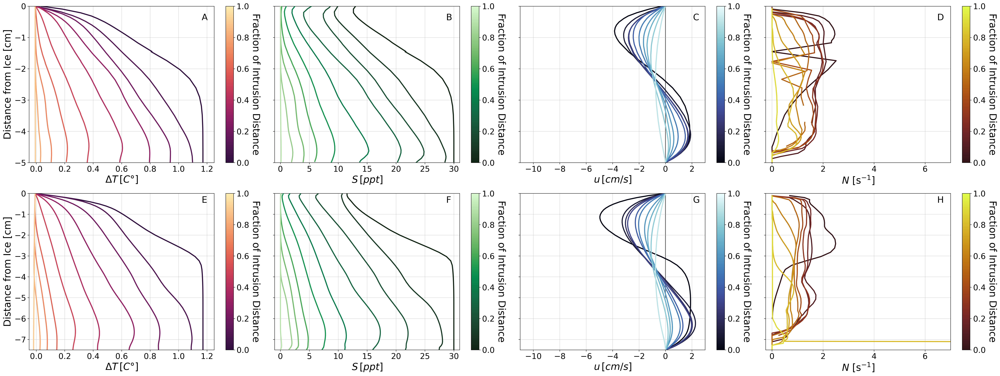

In [89]:
fig, ax = plt.subplots(2, 4, figsize = (32,12), dpi = 300)

trials = [f4cu2_theta1, f5cu2]
locs = [locs_f4, locs_f5]
thetas = [True, False]
i = 0
theta = False

for trial in trials:
    ys = trial[0,:,:]
    n = len(ys[0,:])
    cT = cmo.cm.matter_r(np.linspace(0,1,n+1))
    cS = cmo.cm.algae_r(np.linspace(0,1,n+1))
    cU = cmo.cm.ice(np.linspace(0,1,n+1))
    cN = cmo.cm.solar(np.linspace(0,1,n+1))

    ## non-melting plotting
    Ts = trial[2,:,:]
    Ss = trial[3,:,:]
    us = trial[1,:,:]
    nsq = trial[5,:,:]
    for j in range(0,n):
        if thetas[i] == True:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-np.nanmax(ys[:,j])), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-np.nanmax(ys[:,j])), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 

        else:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-0.075), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-0.075), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-0.075), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-0.075), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 


    ax[i,2].plot(np.zeros(10), np.linspace(-5, 0, 10), color = 'k', alpha = 0.8, zorder = 1)

    

# labelLines(ax[0,0].get_lines(), zorder=2.5,fontsize=8);
# labelLines(ax[0,1].get_lines(), zorder=2.5, fontsize=8);
# labelLines(ax[0,2].get_lines(), zorder=2.5, fontsize=8);
    ax[i,0].set_xlabel('$\Delta T \, [C\degree]$')
    ax[i,1].set_xlabel('$ S \, [ppt]$')
    ax[i,2].set_xlabel('$u \, [cm/s]$');
    ax[i,3].set_xlabel('$N$ [s$^{-1}$]');


    ax[i,0].grid(zorder = 1, alpha = 0.5); ax[i,1].grid(zorder=1, alpha = 0.5); 
    ax[i,2].grid(zorder = 1, alpha = 0.5); ax[i,3].grid(zorder = 1, alpha = 0.5);
    ax[i,0].set_ylabel('Distance from Ice [cm]'); 

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.matter_r),
                 ax=ax[i,0], label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.algae_r),
                 ax=ax[i,1], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.ice),
                 ax=ax[i,2], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.solar),
                 ax=ax[i,3], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    # ax[i,0].legend(np.subtract(locs[i], 2).round(2))
    i = i + 1
ax[0,0].set_ylim(-5,0); ax[0,0].set_xlim(-0.05,1.25);
ax[0,1].set_ylim(-5,0); ax[0,1].set_xlim(-1,31);
ax[0,2].set_ylim(-5,0); ax[0,2].set_xlim(-11,3);
ax[0,3].set_ylim(-5,0); ax[0,3].set_xlim(-0.25,7);

ax[0,1].set_yticks([-5,-4,-3,-2,-1,0])
ax[0,1].set_yticklabels([])
ax[0,2].set_yticks([-5,-4,-3,-2,-1,0])
ax[0,2].set_yticklabels([])
ax[0,3].set_yticks([-5,-4,-3,-2,-1,0])
ax[0,3].set_yticklabels([])

ax[1,0].set_ylim(-7.5,0); ax[1,0].set_xlim(-0.05,1.25);
ax[1,1].set_ylim(-7.5,0); ax[1,1].set_xlim(-1,31);
ax[1,2].set_ylim(-7.5,0); ax[1,2].set_xlim(-11,3);
ax[1,3].set_ylim(-7.5,0); ax[1,3].set_xlim(-0.25,7);
## Letter Panelling ##
ax[0, 0].text(0.93 * 1.25, -0.45, 'A', fontsize = 20)
ax[0, 1].text(0.925 * 31, -0.45, 'B', fontsize = 20)
ax[0, 2].text(0.925 * 2.25, -0.45, 'C', fontsize = 20)
ax[0, 3].text(0.925 * 7, -0.45, 'D', fontsize = 20)

ax[1, 0].text(0.93 * 1.25, -0.45, 'E', fontsize = 20)
ax[1, 1].text(0.925 * 31, -0.45, 'F', fontsize = 20)
ax[1, 2].text(0.925 * 2.25, -0.45, 'G', fontsize = 20)
ax[1, 3].text(0.925 * 7, -0.45, 'H', fontsize = 20)

#ax[1,1].set_yticks([-5,-4,-3,-2,-1,0])
ax[1,1].set_yticklabels([])
#ax[1,2].set_yticks([-5,-4,-3,-2,-1,0])
ax[1,2].set_yticklabels([])
#ax[1,3].set_yticks([-5,-4,-3,-2,-1,0])
ax[1,3].set_yticklabels([])
plt.tight_layout()
fig.savefig('TSU_vprofile_retro_thick.pdf', dpi = 500)

In [98]:
fig, ax = plt.subplots(3, 4, figsize = (32,18), dpi = 300)

trials = [f1cu2_m, f2cu2_m, f3cu2_m]
locs = [locs_f1, locs_f2, locs_f3]
i = 0
theta = False

for trial in trials:
    ys = trial[0,:,:]
    n = 9#len(ys[0,:])
    cT = cmo.cm.matter_r(np.linspace(0,1,n+1))
    cS = cmo.cm.algae_r(np.linspace(0,1,n+1))
    cU = cmo.cm.ice(np.linspace(0,1,n+1))
    cN = cmo.cm.solar(np.linspace(0,1,n+1))

    ## non-melting plotting
    Ts = trial[2,:,:]
    Ss = trial[3,:,:]
    us = trial[1,:,:]
    nsq = trial[5,:,:]
    for j in range(0,n):
        if theta == True:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-np.nanmax(ys[:,j])), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-np.nanmax(ys[:,j])), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 

        else:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-0.05), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-0.05), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-0.05), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-0.05), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 


    ax[i,2].plot(np.zeros(10), np.linspace(-5, 0, 10), color = 'k', alpha = 0.8, zorder = 1)

    ax[i,0].set_ylim(-5,0); ax[i,0].set_xlim(-0.05,1.25);
    ax[i,1].set_ylim(-5,0); ax[i,1].set_xlim(-1,31);
    ax[i,2].set_ylim(-5,0); ax[i,2].set_xlim(-11,3);
    ax[i,3].set_ylim(-5,0); ax[i,3].set_xlim(-0.25,7);

    ax[i,1].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,1].set_yticklabels([])
    ax[i,2].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,2].set_yticklabels([])
    ax[i,3].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,3].set_yticklabels([])

# labelLines(ax[0,0].get_lines(), zorder=2.5,fontsize=8);
# labelLines(ax[0,1].get_lines(), zorder=2.5, fontsize=8);
# labelLines(ax[0,2].get_lines(), zorder=2.5, fontsize=8);
    ax[i,0].set_xlabel('$\Delta T \, [C\degree]$')
    ax[i,1].set_xlabel('$ S \, [ppt]$')
    ax[i,2].set_xlabel('$u \, [cm/s]$');
    ax[i,3].set_xlabel('$N$ [s$^{-1}$]');


    ax[i,0].grid(zorder = 1, alpha = 0.5); ax[i,1].grid(zorder=1, alpha = 0.5); 
    ax[i,2].grid(zorder = 1, alpha = 0.5); ax[i,3].grid(zorder = 1, alpha = 0.5);
    ax[i,0].set_ylabel('Distance from Ice [cm]'); 

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.matter_r),
                 ax=ax[i,0], label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.algae_r),
                 ax=ax[i,1], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.ice),
                 ax=ax[i,2], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.solar),
                 ax=ax[i,3], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    # ax[i,0].legend(np.subtract(locs[i], 2).round(2))
    i = i + 1
plt.tight_layout()
fig.savefig('TSU_vprofile_melting.png', dpi = 500)

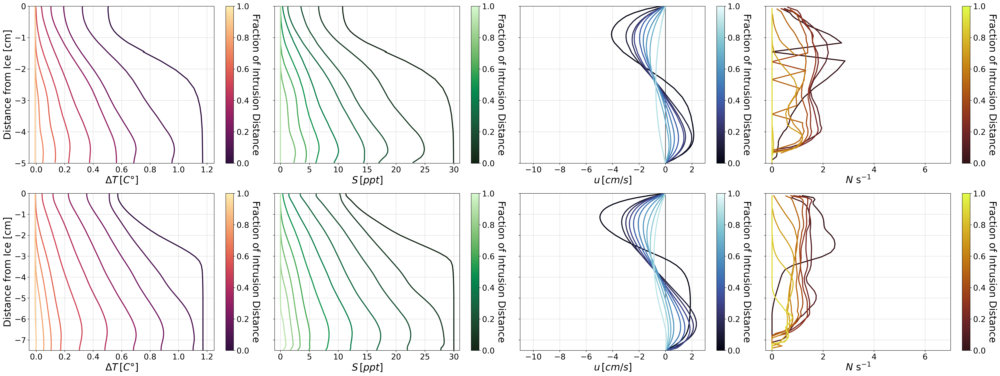

In [84]:
fig, ax = plt.subplots(2, 4, figsize = (32,12), dpi = 300)

trials = [f4cu2_theta1_m, f5cu2_m]
locs = [locs_f4, locs_f5]
thetas = [True, False]
i = 0
theta = False

for trial in trials:
    ys = trial[0,:,:]
    n = len(ys[0,:])
    cT = cmo.cm.matter_r(np.linspace(0,1,n+1))
    cS = cmo.cm.algae_r(np.linspace(0,1,n+1))
    cU = cmo.cm.ice(np.linspace(0,1,n+1))
    cN = cmo.cm.solar(np.linspace(0,1,n+1))

    ## non-melting plotting
    Ts = trial[2,:,:]
    Ss = trial[3,:,:]
    us = trial[1,:,:]
    nsq = trial[5,:,:]
    for j in range(0,n):
        if thetas[i] == True:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-np.nanmax(ys[:,j])), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-np.nanmax(ys[:,j])), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 

        else:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-0.075), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-0.075), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-0.075), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-0.075), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 


    ax[i,2].plot(np.zeros(10), np.linspace(-5, 0, 10), color = 'k', alpha = 0.8, zorder = 1)

    

# labelLines(ax[0,0].get_lines(), zorder=2.5,fontsize=8);
# labelLines(ax[0,1].get_lines(), zorder=2.5, fontsize=8);
# labelLines(ax[0,2].get_lines(), zorder=2.5, fontsize=8);
    ax[i,0].set_xlabel('$\Delta T \, [C\degree]$')
    ax[i,1].set_xlabel('$ S \, [ppt]$')
    ax[i,2].set_xlabel('$u \, [cm/s]$');
    ax[i,3].set_xlabel('$N$ s$^{-1}$');


    ax[i,0].grid(zorder = 1, alpha = 0.5); ax[i,1].grid(zorder=1, alpha = 0.5); 
    ax[i,2].grid(zorder = 1, alpha = 0.5); ax[i,3].grid(zorder = 1, alpha = 0.5);
    ax[i,0].set_ylabel('Distance from Ice [cm]'); 

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.matter_r),
                 ax=ax[i,0], label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.algae_r),
                 ax=ax[i,1], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.ice),
                 ax=ax[i,2], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.solar),
                 ax=ax[i,3], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    # ax[i,0].legend(np.subtract(locs[i], 2).round(2))
    i = i + 1
ax[0,0].set_ylim(-5,0); ax[0,0].set_xlim(-0.05,1.25);
ax[0,1].set_ylim(-5,0); ax[0,1].set_xlim(-1,31);
ax[0,2].set_ylim(-5,0); ax[0,2].set_xlim(-11,3);
ax[0,3].set_ylim(-5,0); ax[0,3].set_xlim(-0.25,7);

ax[0,1].set_yticks([-5,-4,-3,-2,-1,0])
ax[0,1].set_yticklabels([])
ax[0,2].set_yticks([-5,-4,-3,-2,-1,0])
ax[0,2].set_yticklabels([])
ax[0,3].set_yticks([-5,-4,-3,-2,-1,0])
ax[0,3].set_yticklabels([])

ax[1,0].set_ylim(-7.5,0); ax[1,0].set_xlim(-0.05,1.25);
ax[1,1].set_ylim(-7.5,0); ax[1,1].set_xlim(-1,31);
ax[1,2].set_ylim(-7.5,0); ax[1,2].set_xlim(-11,3);
ax[1,3].set_ylim(-7.5,0); ax[1,3].set_xlim(-0.25,7);

#ax[1,1].set_yticks([-5,-4,-3,-2,-1,0])
ax[1,1].set_yticklabels([])
#ax[1,2].set_yticks([-5,-4,-3,-2,-1,0])
ax[1,2].set_yticklabels([])
#ax[1,3].set_yticks([-5,-4,-3,-2,-1,0])
ax[1,3].set_yticklabels([])
plt.tight_layout()
fig.savefig('TSU_vprofile_retro_thick_melting.png', dpi = 500)

## Plotting law of the wall appended figure for varying freshwater velocities

/var/folders/b0/25x33fpn6_jcyj0hj0v0_qpw02w58x/T/ipykernel_5027/3399474812.py:30: UserWarning: Attempt to set non-positive xlim on a log-scaled axis will be ignored.
  ax[j].set_ylim(0,13); ax[j].set_xlim(0, 35)


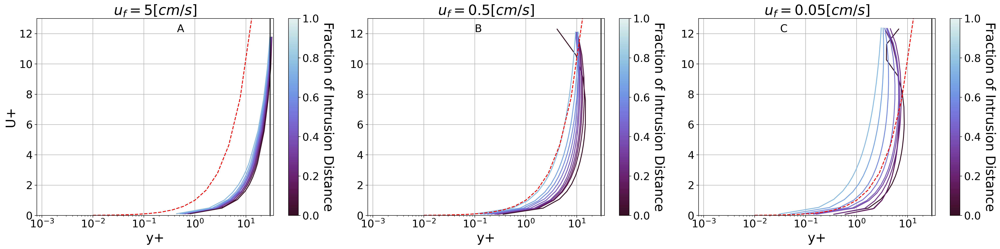

In [85]:
locs = np.subtract(locs_f2,2).round(2)
locs_all = [np.subtract(locs_f1,2).round(2),np.subtract(locs_f2,2).round(2),np.subtract(locs_f3,2).round(2)]
fig, ax = plt.subplots(1,3,figsize = (24,6), dpi = 300)
noMelt = [f1cu2, f2cu2, f3cu2]
x = np.logspace(-2, 20, 100)  # Creates 100 points between 10^-2 and 10^2
y = x  # 1:1 relationship
for j in range(0,3):
    n = len(noMelt[j][0,0,:])
    cT = cmo.cm.dense_r(np.linspace(0,1,n+3))
    for i in range(0,n):
        # ushear, all y's, at loc[0]
        ys = abs(0.05 - noMelt[j][0,:,i]) #absolute distance from the ice
        ushear = noMelt[j][4,:,i]
        u = abs(noMelt[j][1,:,i])

        idx = np.where(ys <= 0.025) # everything within half of the domain. 0.0125 for witin half upper layer
        ys = ys[idx]
        ushear = ushear[idx]
        u = u[idx]

        rho = 1000
        shearStress = ushear**2 * rho
        uplus = u / shearStress

        nu = 1.95 * 10 **(-6)
        yplus = ys * ushear / nu
        ax[j].plot(yplus, uplus, color = cT[i])
    ax[j].plot(x, y, linestyle='--', color='red', label='1:1 Line')
    ax[j].set_xscale('log')
    ax[j].set_ylim(0,13); ax[j].set_xlim(0, 35)
    ax[j].grid()
    ax[j].set_xlabel('y+');
    ax[j].plot(np.ones(10) * 30, np.linspace(0,13,10), color = 'black')


    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.dense_r),
                    ax=ax[j], label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")



# Plot the 1:1 line

ax[0].set_ylabel('U+');

ax[0].set_title('$u_f = 5 [cm/s]$'); ax[1].set_title('$u_f = 0.5 [cm/s]$'); 
ax[2].set_title('$u_f = 0.05 [cm/s]$');

ax[0].text(10**(-0.35), 12.1, 'A', fontsize = 18)
ax[1].text(10**(-1), 12.1, 'B', fontsize = 18)
ax[2].text(10**(-1.5), 12.1, 'C', fontsize = 18)


plt.tight_layout()
plt.savefig('lawOfwall_normies.png', dpi = 500);

## Plotting Law of the Wall for retrograde and thicker subglacial spaces

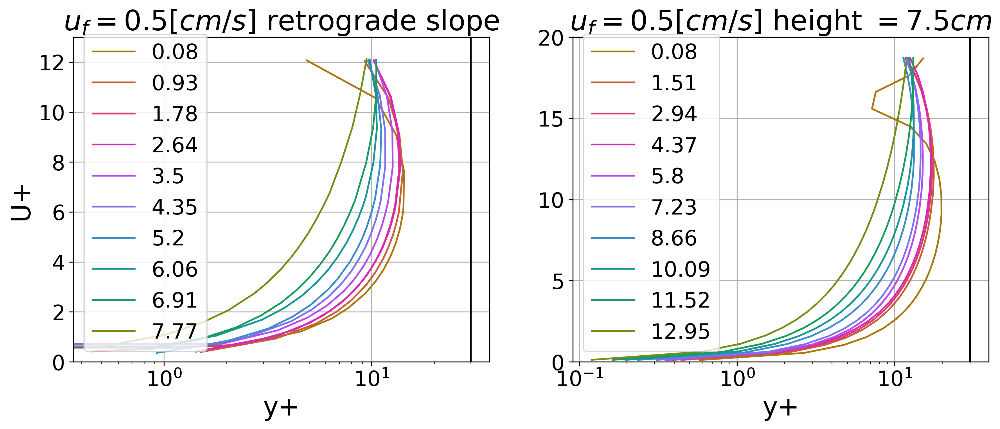

In [86]:
locs = np.subtract(locs_f2,2).round(2)

fig, ax = plt.subplots(1,2,figsize = (14,5), dpi = 300)
noMelt = [f4cu2_theta1, f5cu2]
locs_all = [np.subtract(locs_f4,2).round(2),np.subtract(locs_f5,2).round(2)]

j = 0
n = len(noMelt[j][0,0,:])
cT = cmo.cm.phase(np.linspace(0,1,n+1))
for i in range(0,n):
    # ushear, all y's, at loc[0]
    ys = abs(np.nanmax(noMelt[j][0,:,i]) - noMelt[j][0,:,i]) #absolute distance from the ice
    ushear = noMelt[j][4,:,i]
    u = abs(noMelt[j][1,:,i])

    idx = np.where(ys <= 0.025) # everything within half of the domain. 0.0125 for witin half upper layer
    ys = ys[idx]
    ushear = ushear[idx]
    u = u[idx]

    rho = 1000
    shearStress = ushear**2 * rho
    uplus = u / shearStress
    nu = 1.95 * 10 **(-6)
    yplus = ys * ushear / nu
    ax[j].plot(yplus, uplus, color = cT[i])
    
ax[j].legend(locs_all[j])
ax[j].set_xscale('log')
ax[j].set_ylim(0,13);
ax[j].grid()
ax[j].set_xlabel('y+'); 
ax[j].plot(np.ones(10) * 30, np.linspace(0,13,10), color = 'black')

j = 1
n = len(noMelt[j][0,0,:])
cT = cmo.cm.phase(np.linspace(0,1,n+1))

for i in range(0,n):
    # ushear, all y's, at loc[0]
    ys = abs(0.075 - noMelt[j][0,:,i]) #absolute distance from the ice
    ushear = noMelt[j][4,:,i]
    u = abs(noMelt[j][1,:,i])

    idx = np.where(ys <= 0.0375) # everything within half of the domain. 0.0125 for witin half upper layer
    ys = ys[idx]
    ushear = ushear[idx]
    u = u[idx]

    rho = 1000
    shearStress = ushear**2 * rho
    uplus = u / shearStress
    nu = 1.95 * 10 **(-6)
    yplus = ys * ushear / nu
    ax[j].plot(yplus, uplus, color = cT[i])
    
ax[j].legend(locs_all[j])
ax[j].set_xscale('log')
ax[j].set_ylim(0,20);
ax[j].grid()
ax[j].set_xlabel('y+'); 
ax[j].plot(np.ones(10) * 30, np.linspace(0,20,10), color = 'black')

ax[0].set_ylabel('U+');

ax[0].set_title('$u_f = 0.5 [cm/s]$ retrograde slope');
ax[1].set_title('$u_f = 0.5 [cm/s]$ height $=7.5 cm$');

plt.savefig('lawOfwall_otherGeoms.png',dpi = 500);

In [87]:
locs_f2 = [10.2,10.4,10.6,10.8,10.0,11.2,11.4,11.6,11.8,12.0]

locs_f1 = [10.02,10.04,10.06,10.08,10.12,10.14,10.16,10.18,10.22,10.24]

locs_f3 = [10.25,10.75,11.25,11.75,12.25,12.75,13.25,13.5,13.75,14]
noMelt_f2 = meltSensitivity(F2cu2_body,locs_f2,2)
noMelt_f1 = meltSensitivity(F1cu2_body,locs_f1,2)
noMelt_f3 = meltSensitivity(F3cu2_body,locs_f2,1)



locs = np.subtract(locs_f2,2).round(2)
locs_all = [np.subtract(locs_f1,2).round(2),np.subtract(locs_f2,2).round(2),np.subtract(locs_f3,2).round(2)]
fig, ax = plt.subplots(1,3,figsize = (20,5), dpi = 300)
noMelt = [noMelt_f1, noMelt_f2, noMelt_f3]
for j in range(0,3):
    n = len(noMelt[j][0,0,:])
    cT = cmo.cm.phase(np.linspace(0,1,n+1))
    for i in range(0,n):
        # ushear, all y's, at loc[0]
        ys = noMelt[j][0,:,i]
        idx = np.where(ys <= 0.025)[0]
        rs = abs(0.05 - noMelt[j][0,idx,i]) #absolute distance from the ice
        us = np.abs(noMelt[j][1,idx,i]) #velocity
        max_u = np.nanmax(us)

        vel = us/max_u
        spacing = 1 - (rs/0.025)**2
        
        ax[j].plot(vel, spacing, color = cT[i])
    ax[j].legend(locs_all[j])
    #ax[j].set_xscale('log')
    #ax[j].set_ylim(0,13);
    ax[j].grid()
    ax[j].set_xlabel('us/U_max');
    #ax[j].plot(np.ones(10) * 30, np.linspace(0,13,10), color = 'black')

ax[0].set_ylabel('1 - (r/R)^2');

ax[0].set_title('$u_f = 5 [cm/s]$'); ax[1].set_title('$u_f = 0.5 [cm/s]$'); 
ax[2].set_title('$u_f = 0.05 [cm/s]$');

plt.savefig('parabolicProf_upstream.png',dpi = 500);

TypeError: meltSensitivity() missing 1 required positional argument: 'rOff2'

In [92]:
fig, ax = plt.subplots(4, 4, figsize = (32,24), dpi = 300)

trials = [f2cu1, f2cu2, f2cu3, f2_lam]
locs = [locs_f2, locs_f2, locs_f2, locs_f2]
i = 0
theta = False

for trial in trials:
    ys = trial[0,:,:]
    n = 9#len(ys[0,:])
    cT = cmo.cm.matter_r(np.linspace(0,1,n+1))
    cS = cmo.cm.algae_r(np.linspace(0,1,n+1))
    cU = cmo.cm.ice(np.linspace(0,1,n+1))
    cN = cmo.cm.solar(np.linspace(0,1,n+1))

    ## non-melting plotting
    Ts = trial[2,:,:]
    Ss = trial[3,:,:]
    us = trial[1,:,:]
    nsq = trial[5,:,:]
    for j in range(0,n):
        if theta == True:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-np.nanmax(ys[:,j])), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-np.nanmax(ys[:,j])), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-np.nanmax(ys[:,j])), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 

        else:
            ax[i,0].plot(Ts[:,j] - 273.15 - Tb_eq(Ss[:,j], 1000), 100*(ys[:,j]-0.05), color=cT[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,1].plot(Ss[:,j] * 1000, 100*(ys[:,j]-0.05), color=cS[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 3)
            ax[i,2].plot(us[:,j] * 100,100* (ys[:,j]-0.05), color=cU[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2)
            ax[i,3].plot(nsq[:,j],100* (ys[:,j]-0.05), color=cN[j], linewidth = 2.5, label = str(locs_f2[j]), zorder = 2) 
            

    ax[i,2].plot(np.zeros(10), np.linspace(-5, 0, 10), color = 'k', alpha = 0.8, zorder = 1)

    ax[i,0].set_ylim(-5,0); ax[i,0].set_xlim(-0.05,1.25);
    ax[i,1].set_ylim(-5,0); ax[i,1].set_xlim(-1,31);
    ax[i,2].set_ylim(-5,0); ax[i,2].set_xlim(-11,3);
    ax[i,3].set_ylim(-5,0); ax[i,3].set_xlim(-0.25,7);

    ax[i,1].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,1].set_yticklabels([])
    ax[i,2].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,2].set_yticklabels([])
    ax[i,3].set_yticks([-5,-4,-3,-2,-1,0])
    ax[i,3].set_yticklabels([])

# labelLines(ax[0,0].get_lines(), zorder=2.5,fontsize=8);
# labelLines(ax[0,1].get_lines(), zorder=2.5, fontsize=8);
# labelLines(ax[0,2].get_lines(), zorder=2.5, fontsize=8);
    ax[i,0].set_xlabel('$\Delta T \, [C\degree]$')
    ax[i,1].set_xlabel('$ S \, [ppt]$')
    ax[i,2].set_xlabel('$u \, [cm/s]$');
    ax[i,3].set_xlabel('$N$ [s$^{-1}$]');


    ax[i,0].grid(zorder = 1, alpha = 0.5); ax[i,1].grid(zorder=1, alpha = 0.5); 
    ax[i,2].grid(zorder = 1, alpha = 0.5); ax[i,3].grid(zorder = 1, alpha = 0.5);
    ax[i,0].set_ylabel('Distance from Ice [cm]'); 

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.matter_r),
                 ax=ax[i,0], label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.algae_r),
                 ax=ax[i,1], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.ice),
                 ax=ax[i,2], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")
    
    cbar = fig.colorbar(mpl.cm.ScalarMappable(norm=mpl.colors.Normalize(0, 1), cmap=cmo.cm.solar),
                 ax=ax[i,3], orientation='vertical', label='Fraction of Intrusion Distance')
    cbar.ax.set_ylabel('Fraction of Intrusion Distance', rotation=-90, va="bottom")

    # ax[i,0].legend(np.subtract(locs[i], 2).round(2))
    i = i + 1

## Letter Panelling ##
ax[0, 0].text(0.93 * 1.25, -0.45, 'A', fontsize = 20)
ax[0, 1].text(0.925 * 31, -0.45, 'B', fontsize = 20)
ax[0, 2].text(0.925 * 2.25, -0.45, 'C', fontsize = 20)
ax[0, 3].text(0.925 * 7, -0.45, 'D', fontsize = 20)

ax[1, 0].text(0.93 * 1.25, -0.45, 'E', fontsize = 20)
ax[1, 1].text(0.925 * 31, -0.45, 'F', fontsize = 20)
ax[1, 2].text(0.925 * 2.25, -0.45, 'G', fontsize = 20)
ax[1, 3].text(0.925 * 7, -0.45, 'H', fontsize = 20)

ax[2, 0].text(0.93 * 1.25, -0.45, 'I', fontsize = 20)
ax[2, 1].text(0.925 * 31, -0.45, 'J', fontsize = 20)
ax[2, 2].text(0.925 * 2.25, -0.45, 'K', fontsize = 20)
ax[2, 3].text(0.925 * 7, -0.45, 'L', fontsize = 20)

ax[3, 0].text(0.93 * 1.25, -0.45, 'M', fontsize = 20)
ax[3, 1].text(0.925 * 31, -0.45, 'N', fontsize = 20)
ax[3, 2].text(0.925 * 2.25, -0.45, 'O', fontsize = 20)
ax[3, 3].text(0.925 * 7, -0.45, 'P', fontsize = 20)

plt.tight_layout()
fig.savefig('TSU_vprofile_f2_allTurb.pdf', dpi = 500)